## Graphanol 24C charged model

In [1]:
import torch
import math
import numpy as np
import dscribe
from ase.build import molecule
from dscribe.descriptors import SOAP
from ase.io import read, write
from ase import Atom, Atoms
import time
import os
import sys
import pickle
from ase.io.cube import read_cube, write_cube
from sklearn.metrics import explained_variance_score, mean_squared_error
import py3Dmol
sys.path.append('deepcdp/')
from deepcdp import deepcdp
import torch.nn as nn
import torch.nn.functional as F
from torchsummaryX import summary
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pad_sequence, pack_padded_sequence, pad_packed_sequence
import pandas as pd
import sklearn.metrics as skmetrics
from sklearn.neural_network import MLPRegressor
import gc
import zipfile
import pandas as pd
from tqdm import tqdm
from ase.build import bulk
from ase.visualize.plot import plot_atoms

import datetime
import matplotlib.pyplot as plt
import random
import torch.utils.data as utils_data
from torch.autograd import Variable
from torch.nn.modules.dropout import Dropout
from IPython.display import clear_output
from ase.visualize import view
from IPython.display import Image


import warnings
warnings.filterwarnings('ignore')

device = 'mps' if torch.backends.mps.is_available() else 'cpu'
print("Device: ", device)

# This ensures that the current MacOS version is at least 12.3+
print(torch.backends.mps.is_available())
# This ensures that the current current PyTorch installation was built with MPS activated.
print(torch.backends.mps.is_built())

Device:  mps
True
True


In [2]:
project='GOH_24C_charged'

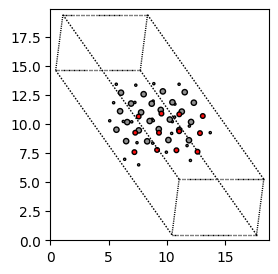

In [3]:
# generating an ASE Atoms object for Si
sample = read_cube(open('data/GOH_24C_charged/GOH-ELECTRON_DENSITY-1_1040.cube'))
ase=sample['atoms']
ase.set_pbc((True, True, True))
fig, ax = plt.subplots(figsize=(3,3))
plot_atoms(ase, ax, radii=0.3, rotation=('45x,45y,0z'))
plt.show()

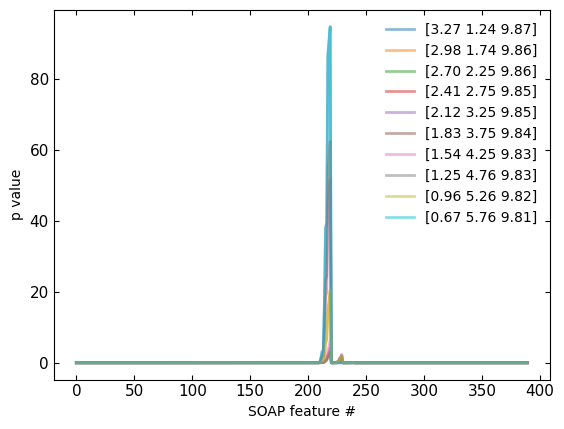

In [4]:
rcut = 5 # Local cut off
nmax = 4 # max number of radial basis functions
lmax = 4 # maximum degree of spherical harmonics

soap_W = SOAP( # W = with weighting
    species=['C','O','H'],
    rcut=rcut,
    nmax=nmax,
    lmax=nmax,
    periodic=True,
    sigma=1,
    sparse=False,
    weighting={"function":"poly","r0":1.5,"c":2,"m":2}
)

# Samping 10 points from first Si atom to the second Si atom
x1, y1, z1 = ase.get_positions()[0]
x2, y2, z2 = ase.get_positions()[4]
num_points = 10

x_values = np.linspace(x1, x2, num_points)
y_values = np.linspace(y1, y2, num_points)
z_values = np.linspace(z1, z2, num_points)

pos_vector = [(x, y, z) for x, y, z in zip(x_values, y_values, z_values)]

# generating soap for each point
soap = soap_W.create(ase, positions = pos_vector)

# plotting and storing the mean soap value
mean_soap = []
for i in range(len(pos_vector)):
    x,y,z=pos_vector[i]
    plt.plot(soap[i],
             label = f'[{x:1.2f} {y:1.2f} {z:1.2f}]',
            alpha=0.5,
            linewidth=2)
    mean_soap += [np.mean(soap[i])]
plt.xlabel('SOAP feature #')
plt.ylabel('p value')
# plt.xlim(0,50)
plt.legend(frameon=False)
plt.tick_params(direction = 'in', right = True, top = True)
plt.tick_params(axis='both', labelsize=11)
plt.tick_params(axis='both', labelsize=11)
plt.show()

In [8]:
# Use the 6 DFT data points.
subsample=1

# Path of the file and filename prefix
datapath = f'data/{project}/'
all_files = os.listdir(f'{datapath}')
data_files =[x for x in all_files 
               if x.split('.')[-1] == 'cube']
idxList=[int(x.split('.cube')[0].split('_')[-1]) 
         for x in data_files if x.split('.')[-1] == 'cube']



cubefile = lambda x:f'{datapath}{x}' # creating a lambda function
print(idxList)
# # generating an object of type deepcdp (imported)
CDP=deepcdp(soap_W)

# generates a box of points. Be mindful of the gamma value used.
CDP.create_box(sample_cubeFile=datapath+data_files[0], gamma=120)

totalfiles=int(os.popen(f'ls {datapath} | wc -l').read().split('\n')[0])

# useing ase's read_cube to read a sample cube file
dicttest=read_cube(open(datapath+data_files[0]))
sampleSubs=dicttest['atoms']
sampleSubs.set_pbc((True, True, True))

# randomly picking snapshots for training
data_files_sub = random.sample(data_files, k=subsample)

# generating final dataset
CDP.generate_cube_data(data_files_sub,cubefile,sampleSubs)


[1451, 1739, 1040, 1353, 1581, 1981, 1179, 1513, 1926, 1815, 1116, 1941, 1777, 1825, 1844]
Read file: data/GOH_24C_charged/GOH-ELECTRON_DENSITY-1_1825.cube
SOAP is of dimension: (324000, 390)


(array([[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]]),
 array([-1.8215e-17, -1.0377e-08, -9.1122e-09, ..., -5.9390e-09,
         9.9928e-09,  1.2363e-08]))

In [9]:
soaps=Variable(torch.Tensor(CDP.trainX))
rhos=Variable(torch.Tensor(CDP.trainY))

In [5]:
# Define the model class

torch.manual_seed(1)

class NN(torch.nn.Module):        
    def __init__(self, input_size, hidden_sizes, output_size):
        super(NN, self).__init__()
        hidden_1, hidden_2, hidden_3,  = hidden_sizes
            
        layers = [
            nn.Linear(input_size, hidden_1),
#             nn.BatchNorm1d(hidden_1),
            nn.ReLU(),
            nn.Linear(hidden_1, hidden_2),
#             nn.BatchNorm1d(hidden_2),
            nn.ReLU(),
            nn.Linear(hidden_2, hidden_3),
#             nn.BatchNorm1d(hidden_3),
#             nn.ReLU(),
#             nn.Linear(hidden_3, hidden_4),
# #             nn.BatchNorm1d(hidden_3),
#             nn.ReLU(),
#             nn.Linear(hidden_4, hidden_5),
#             nn.BatchNorm1d(hidden_3),
            nn.ReLU(),
            nn.Linear(hidden_3, output_size)
        ]
        
        self.layers = nn.Sequential(*layers)
        
#     def _init_weights(self, m):
#         for param in m.parameters():
#             nn.init.uniform_(param.data, -1, 1)
        

    def forward(self, A0):
        x = self.layers(A0)
        return x

In [6]:
def calc_total_elec(rho,spacing_matrix):
    x_cell=spacing_matrix[:,0]
    y_cell=spacing_matrix[:,1]
    z_cell=spacing_matrix[:,2]
    diffV=np.dot(x_cell,np.cross(y_cell,z_cell))
    return torch.sum(rho)*diffV

class L1Loss_SumElect(nn.Module):
    def __init__(self, cell_spacing, alpha=1.0):
        super(L1Loss_SumElect, self).__init__()
        self.cell_spacing = cell_spacing
        self.l1_loss = nn.L1Loss()
        self.alpha = alpha
        
    def forward(self, rho_pred, rho_true):
        l1_loss = self.l1_loss(rho_pred, rho_true)
        tot_ele_diff = self.alpha*(torch.abs(calc_total_elec(rho_pred,self.cell_spacing) - calc_total_elec(rho_true,self.cell_spacing)))
        return l1_loss + tot_ele_diff
    
class MSE_SumElect(nn.Module):
    def __init__(self, cell_spacing, alpha=0.1):
        super(MSE_SumElect, self).__init__()
        self.cell_spacing = cell_spacing
        self.mse = nn.MSELoss()
        self.alpha = alpha
        
    def forward(self, rho_pred, rho_true):
        l1_loss = self.mse(rho_pred, rho_true)
        tot_ele_diff = self.alpha*(torch.abs(calc_total_elec(rho_pred,self.cell_spacing) - calc_total_elec(rho_true,self.cell_spacing)))
        return l1_loss + tot_ele_diff

In [10]:
batch_size=500
# Define the hyperparameters
num_epochs = 40
learning_rate = 5e-4

# Define the model and loss function
model = NN(soap.shape[1], [300,300,300], 1).to(device)

# Defining loss function
cell_spacing = CDP.cell_spacing

# Using the Adam optimizer
optimizer = torch.optim.Adam(model.parameters(), 
                             lr=learning_rate,
                             weight_decay=1e-4)

# Using a ReduceLROnPlateau scheduler on the loss function to tweak the LR.
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                       mode="min", 
                                                       factor=0.5, 
                                                       patience=2, 
                                                       verbose=True, 
                                                       threshold=0.01)


training_samples = utils_data.TensorDataset(soaps, rhos)
data_loader_trn = utils_data.DataLoader(training_samples, 
                                        batch_size=batch_size, 
                                        drop_last=False, 
                                        shuffle=True)

In [11]:
model = NN(soap.shape[1], [300,300,300], 1).to(device)
print(os.listdir(f'sample-models/{project}/'))

['GOH-mae-n-5.pt', 'GOH-mae-n2-7.pt', 'GOH-7.pt', 'GOH-mae-n-1.pt', 'GOH-mae-n2-3.pt', 'GOH-mae-n2-19.pt', 'GOH-mae-1.pt', 'GOH-3.pt', 'GOH-21.pt', 'GOH-15.pt', 'GOH-11.pt', 'GOH-mae-n-21.pt', 'GOH-mae-n-15.pt', 'GOH-mae-n2-23.pt', 'GOH-mae-n2-17.pt', 'GOH-mae-n2-9.pt', 'GOH-mae-n-11.pt', 'GOH-mae-n-25.pt', 'GOH-9.pt', 'GOH-mae-n2-13.pt', 'cum_loss.dat', 'cum_loss-mae.dat', 'cum_loss-mae-n2.dat', 'GOH-mae-n-9.pt', 'GOH-mae-n-13.pt', 'GOH-mae-n2-11.pt', 'GOH-mae-n-23.pt', 'GOH-mae-n-17.pt', 'GOH-mae-n2-21.pt', 'GOH-mae-n2-15.pt', 'cum_loss-mae-n.dat', 'GOH-19.pt', 'GOH-mae-n-19.pt', 'GOH-mae-n2-1.pt', 'GOH-mae-n-3.pt', 'GOH-mae-3.pt', 'GOH-1.pt', 'GOH-mae-n2-5.pt', 'GOH-mae-n-7.pt', 'GOH-5.pt', 'GOH-13.pt', 'GOH-4.pt', 'GOH-23.pt', 'GOH-17.pt']


In [12]:
model_dict=torch.load(f'sample-models/GOH_24C_charged/GOH-mae-n-5.pt')
model.load_state_dict(model_dict['model_state_dict'])
# optimizer.load_state_dict(model_dict['optimizer_state_dict'])
# scheduler.load_state_dict(model_dict['scheduler_state_dict'])

<All keys matched successfully>

Epoch 1/40: Train Loss 10.2489, Learning Rate 0.0005


Epoch 2/40: Train Loss 10.3387, Learning Rate 0.0005
Training R2 value: 0.9887
Saving model


Epoch 3/40: Train Loss 10.0534, Learning Rate 0.0005


Epoch 4/40: Train Loss 10.2949, Learning Rate 0.0005
Training R2 value: 0.9885
Saving model


Epoch 5/40: Train Loss 10.0728, Learning Rate 0.0005


Epoch 6/40: Train Loss 10.0819, Learning Rate 0.0005
Epoch 00006: reducing learning rate of group 0 to 2.5000e-04.
Training R2 value: 0.9885
Saving model


Epoch 7/40: Train Loss 10.0858, Learning Rate 0.0005


Epoch 8/40: Train Loss 10.1012, Learning Rate 0.0005
Training R2 value: 0.9869
Saving model


Epoch 9/40: Train Loss 10.2769, Learning Rate 0.0005
Epoch 00009: reducing learning rate of group 0 to 1.2500e-04.


Epoch 10/40: Train Loss 10.0935, Learning Rate 0.0005
Epoch [10/40], Loss: 10.0935


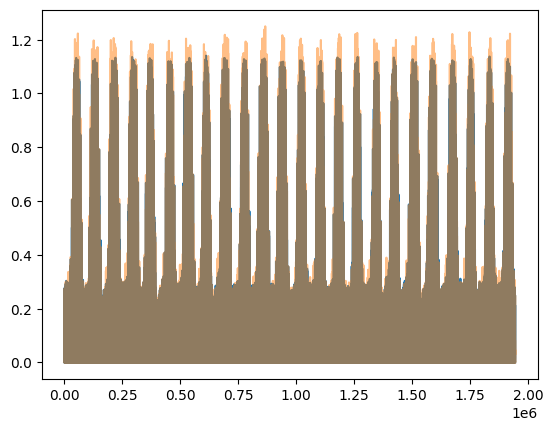

Training R2 value: 0.9877
Saving model


Epoch 11/40: Train Loss 10.1109, Learning Rate 0.0005


Epoch 12/40: Train Loss 10.0991, Learning Rate 0.0005
Epoch 00012: reducing learning rate of group 0 to 6.2500e-05.
Training R2 value: 0.9878
Saving model


Epoch 13/40: Train Loss 9.9181, Learning Rate 0.0005


Epoch 14/40: Train Loss 9.9173, Learning Rate 0.0005
Training R2 value: 0.9872
Saving model


Epoch 15/40: Train Loss 9.8685, Learning Rate 0.0005


Epoch 16/40: Train Loss 9.9748, Learning Rate 0.0005
Epoch 00016: reducing learning rate of group 0 to 3.1250e-05.
Training R2 value: 0.9879
Saving model


Epoch 17/40: Train Loss 9.8325, Learning Rate 0.0005


Epoch 18/40: Train Loss 9.9197, Learning Rate 0.0005
Training R2 value: 0.9885
Saving model


Epoch 19/40: Train Loss 9.9587, Learning Rate 0.0005
Epoch 00019: reducing learning rate of group 0 to 1.5625e-05.


Epoch 20/40: Train Loss 9.8527, Learning Rate 0.0005
Epoch [20/40], Loss: 9.8527


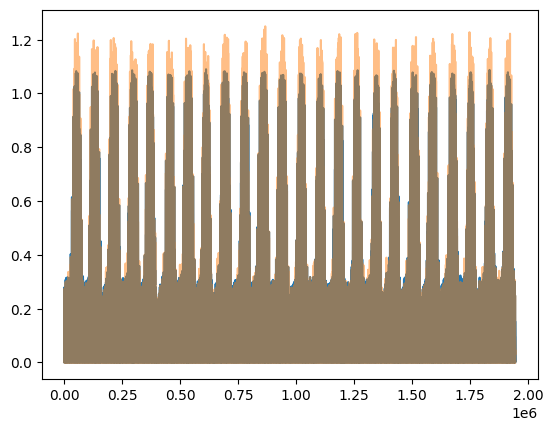

Training R2 value: 0.9879
Saving model


Epoch 21/40: Train Loss 10.0037, Learning Rate 0.0005


Epoch 22/40: Train Loss 9.8476, Learning Rate 0.0005
Epoch 00022: reducing learning rate of group 0 to 7.8125e-06.
Training R2 value: 0.9866
Saving model


Epoch 23/40: Train Loss 9.7792, Learning Rate 0.0005


Epoch 24/40: Train Loss 9.9273, Learning Rate 0.0005
Training R2 value: 0.9876
Saving model


Train:  85%|█████████▎ | 3293/3888 [15:16<00:14, 40.42it/s, loss=8.4264, lr=0.0005]

KeyboardInterrupt: 

In [12]:
# Train the model

criterion_mae = L1Loss_SumElect(cell_spacing, alpha=0.1)
criterion_mse = MSE_SumElect(cell_spacing, alpha=0.1)

optimizer = torch.optim.Adam(model.parameters(), 
                             lr=5e-4,
                             weight_decay=1e-4)

cum_loss_epoch=[]
for epoch in range(num_epochs):
    batch_bar = tqdm(total=len(data_loader_trn), dynamic_ncols=True, leave=False, position=0, desc='Train') 
    model.train()
    cum_loss = 0
    # Convert inputs and labels to tensors
    
    for batch_idx, (data, target) in enumerate(data_loader_trn):
        inputs = (data.float()).to(device)
        labels = (target.float()).reshape(-1,1).to(device)
        
        # Forward pass
        outputs = model(inputs)
        
        loss = criterion_mae(outputs, labels)
        
#         loss = criterion_mae(outputs, labels)
        
        # Backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        cum_loss+=loss.item()
        batch_bar.set_postfix(
            loss="{:.04f}".format(cum_loss),
            lr="{:.04f}".format(float(optimizer.param_groups[0]['lr'])))
        batch_bar.update()
    batch_bar.close()
    print("Epoch {}/{}: Train Loss {:.04f}, Learning Rate {:.04f}".format(
        epoch + 1,
        num_epochs,
        float(cum_loss), 
        float(float(optimizer.param_groups[0]['lr']))
        ))

    scheduler.step(cum_loss)
    cum_loss_epoch +=[cum_loss]
    np.savetxt(f'sample-models/{project}/cum_loss-mae-n2.dat',cum_loss_epoch)

    if (epoch+1) % 10 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {cum_loss:.4f}')
        plt.plot(model(soaps.to(device)).cpu().detach().numpy())
        plt.plot(rhos, alpha=0.5)
        plt.show()

    if (epoch+1)%2==0:
        model.eval()
        acc=skmetrics.r2_score(model(soaps.to(device)).cpu().detach().numpy(),rhos)
        print(f"Training R2 value: {acc:1.4f}")
        
    if (epoch+1) % 2 == 0:
        
        print('Saving model')
        torch.save({
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'scheduler_state_dict' : scheduler.state_dict(),
    }, f"sample-models/{project}/GOH-mae-n2-"+str(epoch)+".pt")
#     print()

### Testing on unit cell 

In [43]:
CDP_i = deepcdp(None)
CDP_i.create_box(sample_cubeFile='data/GOH_unitcell/GOH-ELECTRON_DENSITY-1_1030.cube', gamma=120)

In [12]:
model.eval()
# Testing 0 Cu structure
test_cube_path = f'data/GOH_unitcell/GOH-ELECTRON_DENSITY-1_1030.cube'
test_cube = read_cube(open(test_cube_path))
ase_atoms_test = test_cube['atoms']
ase_atoms_test.set_pbc((True, True, True))
pos_atoms_test = ase_atoms_test.get_positions()
rho_test = test_cube['data']
rho_test = rho_test.ravel().reshape(-1,1)

start = time.time()
soap_test = soap_W.create(ase_atoms_test, positions=CDP_i.box)
rho_pred = model(torch.tensor(soap_test, dtype=torch.float32).to(device)).cpu().detach().numpy()

end = time.time()
print("Prediction time: ", (end - start), " seconds.")
print(f'R2 value: {skmetrics.r2_score(rho_test,rho_pred):1.2f}')
print(f'MSE value: {skmetrics.mean_squared_error(rho_test,rho_pred):1.5f}')


In [45]:
100*np.sum(np.abs(rho_test - rho_pred))/np.sum(rho_test)

13.565998702415948

Train:  15%|█▍        | 580/3888 [00:33<01:14, 44.52it/s, loss=4.8227, lr=0.0003]

In [46]:
out_path='example/predictions/GOH_unitcell/pred-1030-torch-2.cube'
out=open(out_path,'w+')
rho_test_resp = rho_pred.reshape(*CDP_i.bounds)
write_cube(out,ase_atoms_test,rho_test_resp,origin=CDP.box[0])

In [47]:
cube_predict=open(out_path).read()
cube_dft=open(test_cube_path).read()
struct_path = 'example/structures/GOH_unitcell/water-1030.xyz'
CDP.cube2xyz(test_cube_path,struct_path)
isoval=0.08
xyz=open(struct_path).read()
xyzview = py3Dmol.view(width=400,height=400)
xyzview.addVolumetricData(cube_predict,'cube',{'isoval': isoval,"color":'red','opacity':1,'wireframe':True})
xyzview.addVolumetricData(cube_dft,'cube',{'isoval': isoval,"color":'grey','opacity':1,'wireframe':True})
xyzview.addModel(xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [29]:
rho_test_resp.shape
rho_test = test_cube['data']
error = np.abs(rho_test - rho_test_resp)
out=open('example/predictions/GOH_unitcell/pred-1030-error.cube','w+')
write_cube(out,ase_atoms_test,error,origin=CDP_i.box[0])

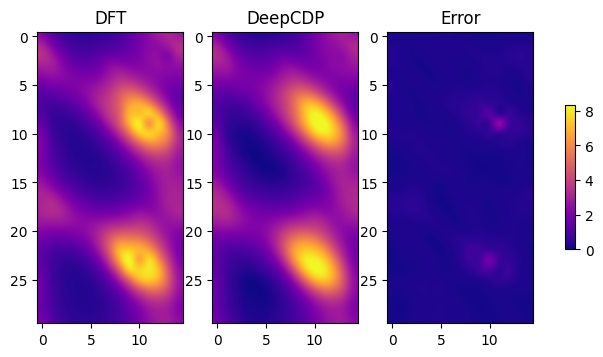

In [30]:
vmin = 0
vmax = 8.3
plt.subplot(131)
plt.imshow(np.trapz(rho_test, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DFT')
plt.subplot(132)
plt.imshow(np.trapz(rho_test_resp, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DeepCDP')
plt.subplot(133)
plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)
# plt.savefig('Images/LiF-example.png',dpi=600,bbox_inches="tight",)

## Testing model on 24C uncharged

In [97]:
CDP_i = deepcdp(None)
CDP_i.create_box(sample_cubeFile='data/GOH_24C_uncharged/GOH-ELECTRON_DENSITY-1_1680.cube', gamma=120)

In [98]:
model.eval()
# Testing 0 Cu structure
test_cube_path = f'data/GOH_24C_uncharged/GOH-ELECTRON_DENSITY-1_1680.cube'
test_cube = read_cube(open(test_cube_path))
ase_atoms_test = test_cube['atoms']
ase_atoms_test.set_pbc((True, True, True))
pos_atoms_test = ase_atoms_test.get_positions()
rho_test = test_cube['data']
rho_test = rho_test.ravel().reshape(-1,1)

start = time.time()
soap_test = soap_W.create(ase_atoms_test, positions=CDP_i.box)
rho_pred = model(torch.tensor(soap_test, dtype=torch.float32).to(device)).cpu().detach().numpy()

end = time.time()
print("Prediction time: ", (end - start), " seconds.")
print(f'R2 value: {skmetrics.r2_score(rho_test,rho_pred):1.2f}')
print(f'MSE value: {skmetrics.mean_squared_error(rho_test,rho_pred):1.5f}')

Prediction time:  16.364896059036255  seconds.
R2 value: 0.99
MSE value: 0.00005


In [99]:
out_path='example/predictions/GOH_24C_uncharged/pred-GOH_uncharged-1680-c24C-model.cube'
out=open(out_path,'w+')
rho_test_resp = rho_pred.reshape(*CDP_i.bounds)
write_cube(out,ase_atoms_test,rho_test_resp,origin=CDP_i.box[0])

In [100]:
rho_test_resp.shape
rho_test = test_cube['data']
error = np.abs(rho_test - rho_test_resp)
out=open('example/predictions/GOH_24C_uncharged/pred-1770-error-c24C-model.cube','w+')
write_cube(out,ase_atoms_test,error,origin=CDP_i.box[0])

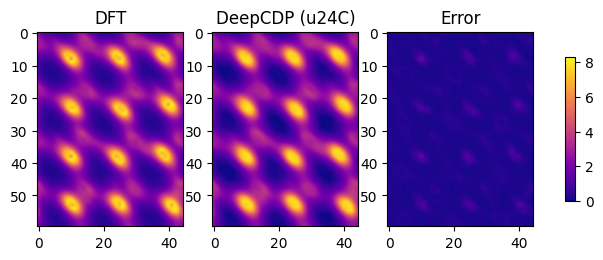

In [87]:
vmin = 0
vmax = 8.3
plt.subplot(131)
plt.imshow(np.trapz(rho_test, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DFT')
plt.subplot(132)
plt.imshow(np.trapz(rho_test_resp, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DeepCDP (u24C)')
plt.subplot(133)
plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)
plt.savefig('Images/c24C-model-test-u24C.png',dpi=600,bbox_inches="tight",)

In [88]:
def calc_total_elec(rho,spacing_matrix):
    x_cell=spacing_matrix[:,0]
    y_cell=spacing_matrix[:,1]
    z_cell=spacing_matrix[:,2]
    diffV=np.dot(x_cell,np.cross(y_cell,z_cell))
    return np.sum(rho)*diffV

In [101]:
eDFT=calc_total_elec(rho_test, CDP_i.cell_spacing)
eCDP=calc_total_elec(rho_test_resp, CDP_i.cell_spacing)

## Testing on charged system

In [294]:
CDP = deepcdp(None)
CDP.create_box(sample_cubeFile='data/GOH_24C_charged/GOH-ELECTRON_DENSITY-1_1981.cube', gamma=120)

In [298]:
model.eval()
# Testing 0 Cu structure
test_cube_path = f'data/GOH_24C_charged/GOH-ELECTRON_DENSITY-1_1981.cube'
test_cube = read_cube(open(test_cube_path))
ase_atoms_test = test_cube['atoms']
ase_atoms_test.set_pbc((True, True, True))
pos_atoms_test = ase_atoms_test.get_positions()
rho_test = test_cube['data']
rho_test = rho_test.ravel().reshape(-1,1)

start = time.time()
soap_test = soap_W.create(ase_atoms_test, positions=CDP.box)
rho_pred = model(torch.tensor(soap_test, dtype=torch.float32).to(device)).cpu().detach().numpy()

end = time.time()
print("Prediction time: ", (end - start), " seconds.")
print(f'R2 value: {skmetrics.r2_score(rho_test,rho_pred):1.3f}')
print(f'MSE value: {skmetrics.mean_squared_error(rho_test,rho_pred):1.5f}')

Prediction time:  16.59335494041443  seconds.
R2 value: 0.988
MSE value: 0.00006


In [296]:
out_path='example/predictions/GOH_24C_charged/pred-GOH_1981-3.cube'
out=open(out_path,'w+')
rho_test_resp = rho_pred.reshape(*CDP.bounds)
write_cube(out,ase_atoms_test,rho_test_resp,origin=CDP.box[0])

In [299]:
cube_predict=open(out_path).read()
cube_dft=open(test_cube_path).read()
struct_path = 'example/structures/GOH_24C_charged/GOH-1981.xyz'
CDP.cube2xyz(test_cube_path,struct_path)
isoval=0.08
xyz=open(struct_path).read()
xyzview = py3Dmol.view(width=400,height=400)
xyzview.addVolumetricData(cube_predict,'cube',{'isoval': isoval,"color":'red','opacity':1,'wireframe':True})
xyzview.addVolumetricData(cube_dft,'cube',{'isoval': isoval,"color":'grey','opacity':1,'wireframe':True})
xyzview.addModel(xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [300]:
rho_test_resp.shape
rho_test = test_cube['data']
error = np.abs(rho_test - rho_test_resp)
out=open('example/predictions/GOH_24C_charged/pred-1981-error-3.cube','w+')
write_cube(out,ase_atoms_test,error,origin=CDP.box[0])

In [ ]:
error_predict=open('example/predictions/GOH_24C_charged/pred-1981-error-3.cube').read()
xyzview = py3Dmol.view(width=400,height=400)
xyzview.addVolumetricData(error_predict,'cube',{'isoval': 0.08,"color":'blue','opacity':1,'wireframe':True})
# xyzview.addModel(water_xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

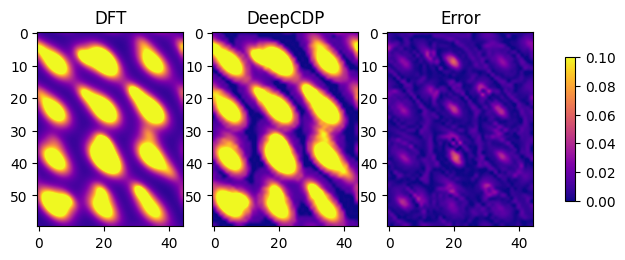

In [302]:
# plt.imshow(rho_test[:,:,69], cmap='plasma',
#        interpolation ='spline36')
# plt.colorbar()
# plt.title(i)
# plt.show()

vmin = 0
vmax = 0.1
plt.subplot(131)
plt.imshow(rho_test[:,:,69], cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DFT')
plt.subplot(132)
plt.imshow(rho_test_resp[:,:,69], cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DeepCDP')
plt.subplot(133)
plt.imshow(error[:,:,69], cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)
plt.savefig('Images/c-24C-GOH-hbonding.png',dpi=600,bbox_inches="tight",)

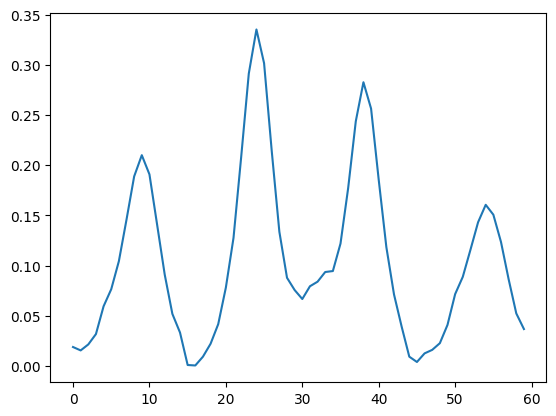

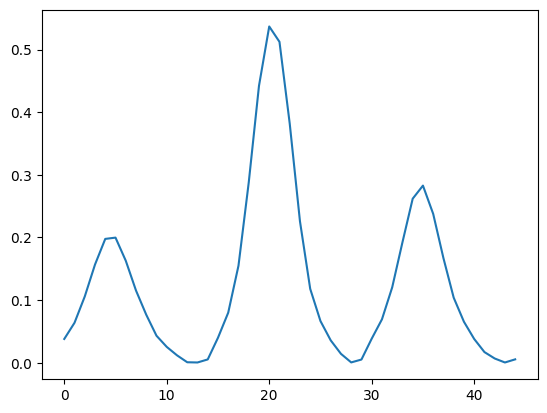

In [28]:
plt.plot(rho_test_resp[:,35,69])
plt.show()
plt.plot(rho_test_resp[38,:,69])
plt.show()

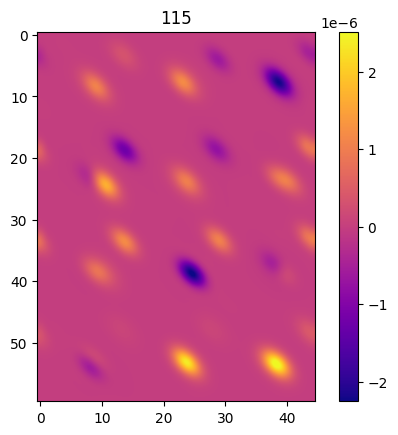

In [34]:
plt.subplot(131)
for i in range(0,rho_test.shape[-1],5):
    clear_output(wait=True)
    plt.imshow(rho_test[:,:,i], cmap='plasma',
           interpolation ='spline36')
    plt.colorbar()
    plt.title(i)
    plt.show()
# plt.title('DFT')
# plt.subplot(132)
# plt.imshow(np.trapz(rho_test_resp, axis=2 ), cmap='plasma',
#            interpolation ='spline36', vmin=vmin, vmax=vmax)
# plt.title('DeepCDP')
# plt.subplot(133)
# plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
#            interpolation ='spline36', vmin=vmin, vmax=vmax)
# plt.title('Error')
# plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
# cax = plt.axes([0.95, 0.3, 0.015, 0.3])
# plt.colorbar(cax=cax)

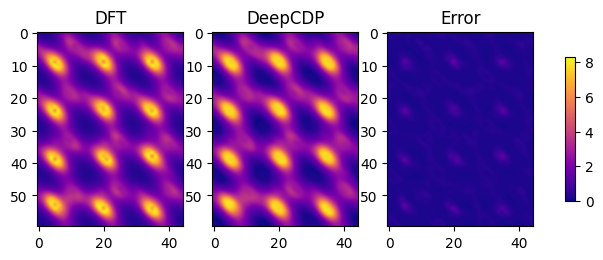

In [82]:
vmin = 0
vmax = 8.3
plt.subplot(131)
plt.imshow(np.trapz(rho_test, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DFT')
plt.subplot(132)
plt.imshow(np.trapz(rho_test_resp, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DeepCDP')
plt.subplot(133)
plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)
plt.savefig('Images/c24C-model-test-c24C.png',dpi=600,bbox_inches="tight",)

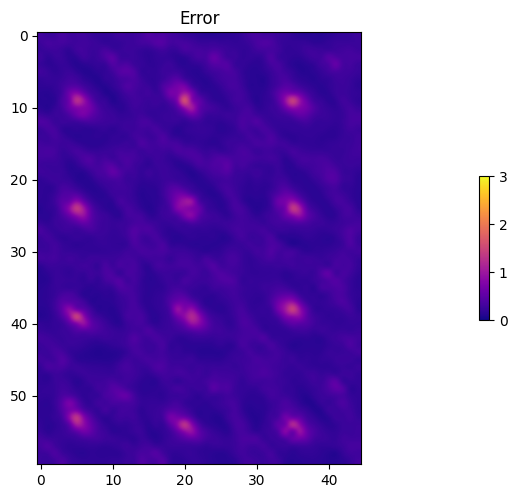

In [78]:
plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=0, vmax=3)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)

In [79]:
def calc_total_elec(rho,spacing_matrix):
    x_cell=spacing_matrix[:,0]
    y_cell=spacing_matrix[:,1]
    z_cell=spacing_matrix[:,2]
    diffV=np.dot(x_cell,np.cross(y_cell,z_cell))
    return np.sum(rho)*diffV

In [80]:
eDFT=calc_total_elec(rho_test, CDP.cell_spacing)
eCDP=calc_total_elec(rho_test_resp, CDP.cell_spacing)

In [81]:
eDFT, eCDP

(191.99730404086924, 191.62480138895646)

## Predicting electron densities only at atom centers and checking charge locations


In [31]:
test_cube_path = f'data/GOH_24C_charged/GOH-ELECTRON_DENSITY-1_1981.cube'
test_cube = read_cube(open(test_cube_path))
ase_atoms_test = test_cube['atoms']
ase_atoms_test.set_pbc((True, True, True))
pos_atoms_test = ase_atoms_test.get_positions()
rho_test = test_cube['data']
rho_test = rho_test.ravel().reshape(-1,1)
O_ind=[x == 'O' for x in ase_atoms_test.get_chemical_symbols()]
O_pos = ase_atoms_test.get_positions()[O_ind]
O_ind_n = np.arange(0,len(ase_atoms_test.get_positions()))[O_ind]

H_ind=[x == 'H' for x in ase_atoms_test.get_chemical_symbols()]
H_pos = ase_atoms_test.get_positions()[H_ind]

H_ind_n = np.arange(0,len(ase_atoms_test.get_positions()))[H_ind]
C_ind=[x == 'C' for x in ase_atoms_test.get_chemical_symbols()]
C_pos = ase_atoms_test.get_positions()[C_ind]
C_ind_n = np.arange(0,len(ase_atoms_test.get_positions()))[C_ind]


soap_o = soap_W.create(ase_atoms_test, positions=O_pos)
rho_pre_o = model(torch.tensor(soap_o, dtype=torch.float32).to(device)).cpu().detach().numpy()


In [32]:
H_pos[H_pos[:,2] > 10]
H_ind_n[H_pos[:,2] > 10]
# H_pos = ase_atoms_test.get_positions()[H_ind]

array([48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60])

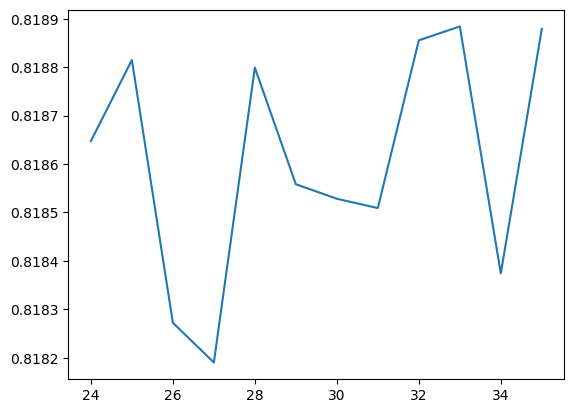

In [33]:
plt.plot(O_ind_n,rho_pre_o)

In [47]:
soap_h = soap_W.create(ase_atoms_test, positions=H_pos)
rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()


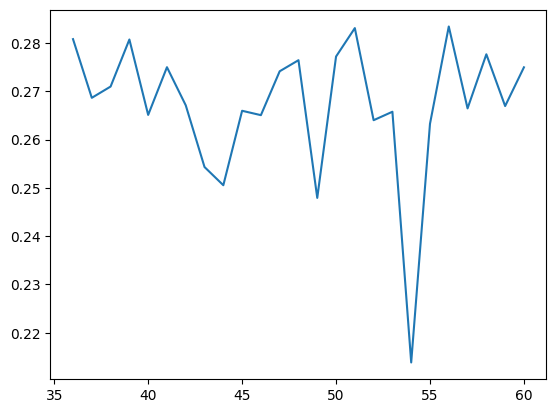

In [48]:
plt.plot(H_ind_n,rho_pre_h)

The oxygen may not be an ideal indicator of the charge center, but the H atoms itself. Let's try to compute the charge locations for eaech of these images. 

In [101]:
# view()

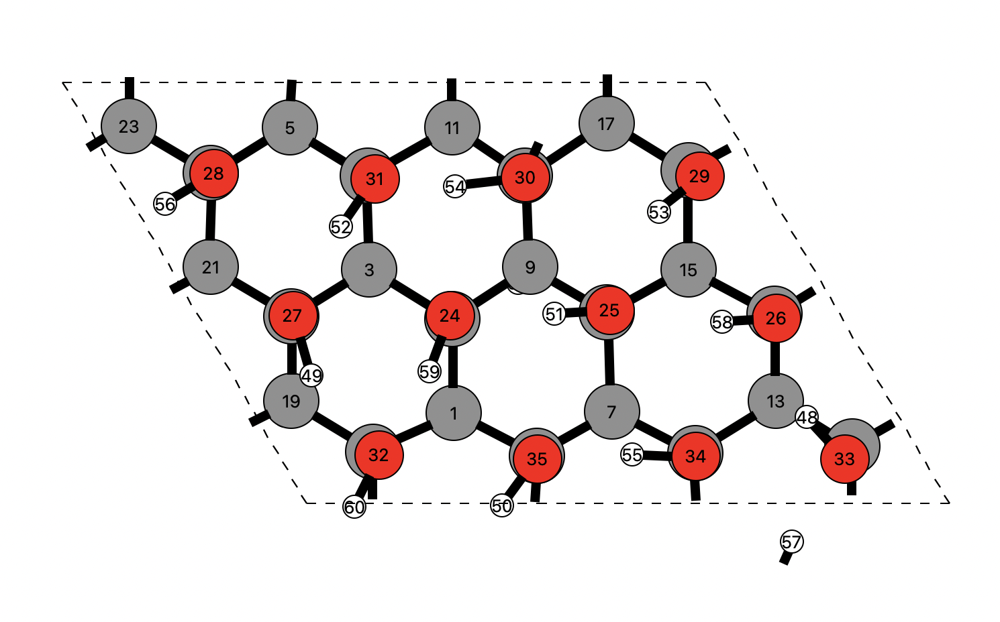

In [ ]:
# view(ase_atoms_test);
Image('Images/GOH_test_image.png')

In [115]:
spacing_matrix=CDP.cell_spacing
x_cell=spacing_matrix[:,0]
y_cell=spacing_matrix[:,1]
z_cell=spacing_matrix[:,2]
diffV=np.dot(x_cell,np.cross(y_cell,z_cell))

In [183]:
x_cell, y_cell, z_cell

(array([ 0.324183, -0.163944,  0.      ]),
 array([0.     , 0.28396, 0.     ]),
 array([0.      , 0.      , 0.314954]))

In [116]:
def generate_points(center, cutoff_radius, num_points):
    points = []
    while len(points) < num_points:
        # Generate a random point within the unit cube
        x, y, z = random.uniform(-1, 1), random.uniform(-1, 1), random.uniform(-1, 1)
        # If the point is outside the unit sphere, discard it and try again
        if x**2 + y**2 + z**2 > 1:
            continue
        # Scale the point to the desired cutoff radius and translate it to the center of the sphere
        x, y, z = [cutoff_radius * coord + center[i] for i, coord in enumerate([x, y, z])]
        points.append((x, y, z))
    return points


In [117]:
t=soap_W.create(ase_atoms_test, generate_points([0,0,0],2.0, 10))
rho_pre_h = model(torch.tensor(t, dtype=torch.float32).to(device)).cpu().detach().numpy()
sum(rho_pre_h)*diffV

array([9.970333e-05], dtype=float32)

In [118]:
def get_h_eden(test_cube_path):
    test_cube = read_cube(open(test_cube_path))
    ase_atoms_test = test_cube['atoms']
    ase_atoms_test.set_pbc((True, True, True))
    pos_atoms_test = ase_atoms_test.get_positions()
    H_ind=[x == 'H' for x in ase_atoms_test.get_chemical_symbols()]
    H_pos = ase_atoms_test.get_positions()[H_ind]
    H_ind_n = np.arange(0,len(ase_atoms_test.get_positions()))[H_ind]
    H_pos_up = H_pos[H_pos[:,2] > 10]
    H_ind_n_up = H_ind_n[H_pos[:,2] > 10]
    integral_list = []
    for h in H_pos_up:
        soap_h = soap_W.create(ase_atoms_test, positions=generate_points(h,2.5,10))
        rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()
        int_r = sum(rho_pre_h)*diffV
        integral_list += [int_r]
    return H_ind_n_up, integral_list

In [102]:
for f in os.listdir('data/GOH_24C_charged/'):
    b=get_h_eden(f'data/GOH_24C_charged/{f}')
    print(f, ' || Proton index: ', b[0][np.argmin(b[1])])
#     plt.plot(b[0],b[1])
#     plt.show()
#     plt.plot(b[0],b[1])
    

GOH-ELECTRON_DENSITY-1_1451.cube  || Proton index:  56
GOH-ELECTRON_DENSITY-1_1739.cube  || Proton index:  48
GOH-ELECTRON_DENSITY-1_1040.cube  || Proton index:  59
GOH-ELECTRON_DENSITY-1_1353.cube  || Proton index:  53
GOH-ELECTRON_DENSITY-1_1581.cube  || Proton index:  55
GOH-ELECTRON_DENSITY-1_1981.cube  || Proton index:  54
GOH-ELECTRON_DENSITY-1_1179.cube  || Proton index:  54
GOH-ELECTRON_DENSITY-1_1513.cube  || Proton index:  56
GOH-ELECTRON_DENSITY-1_1926.cube  || Proton index:  57
GOH-ELECTRON_DENSITY-1_1815.cube  || Proton index:  57
GOH-ELECTRON_DENSITY-1_1116.cube  || Proton index:  51
GOH-ELECTRON_DENSITY-1_1941.cube  || Proton index:  57
GOH-ELECTRON_DENSITY-1_1777.cube  || Proton index:  48
GOH-ELECTRON_DENSITY-1_1825.cube  || Proton index:  48
GOH-ELECTRON_DENSITY-1_1844.cube  || Proton index:  57


In [35]:
# Randomly sample configurations from a DFT-MD simulaiton
datafile='../../../Graphanol-DP-temp/Files/XDATCAR_24C-aimd-1000K-cont'
md=os.popen(f'cat {datafile}').read().split('Direct configuration=')
sample_ase=read('../../../Graphanol-DP-temp/Files/GOH_xdat.poscar')

In [153]:
c = np.array([1,1,1])
# [c+x for x in []]
soap_h = soap_W.create(ase_atoms_test, positions=np.vstack([c - np.identity(3)*diffV,c + np.identity(3)*diffV]))
rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()

In [249]:
np.vstack([c, c - np.identity(3)*diffV,c + np.identity(3)*diffV])

array([[1.        , 1.        , 1.        ],
       [0.97100691, 1.        , 1.        ],
       [1.        , 0.97100691, 1.        ],
       [1.        , 1.        , 0.97100691],
       [1.02899309, 1.        , 1.        ],
       [1.        , 1.02899309, 1.        ],
       [1.        , 1.        , 1.02899309]])

In [276]:
def xdatcar_proton(popen, ase_atoms_test, md_index):
    mdsplit=popen[md_index].split('\n')[1:-1]
    scaled = np.array([list(map(float, row.split())) for row in mdsplit])
    ase_atoms_test.set_scaled_positions(scaled)
    H_ind=[x == 'H' for x in ase_atoms_test.get_chemical_symbols()]
    H_pos = ase_atoms_test.get_positions()[H_ind]
    H_ind_n = np.arange(0,len(ase_atoms_test.get_positions()))[H_ind]
    H_pos_up = H_pos[H_pos[:,2] > 10]
    H_ind_n_up = H_ind_n[H_pos[:,2] > 10]
    
    integral_list = []
    
    soap_h = soap_W.create(ase_atoms_test, positions=H_pos_up)
    rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()
    return H_ind_n_up, rho_pre_h.T[0], ase_atoms_test
    
#     for h in H_pos_up:
#         soap_h = soap_W.create(ase_atoms_test, positions=
#                               np.vstack([h, h - np.identity(3)*diffV,h + np.identity(3)*diffV]))
# #         soap_h = soap_W.create(ase_atoms_test, positions=h)
#         rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()
#         int_r = np.sum(rho_pre_h)*diffV
#         integral_list += [int_r]
#     return H_ind_n_up, integral_list, ase_atoms_test
    
#     integral_list =[]    
#     for h in H_pos_up:
#         soap_h = soap_W.create(ase_atoms_test, positions=generate_points(h,1.5,20))
#         rho_pre_h = model(torch.tensor(soap_h, dtype=torch.float32).to(device)).cpu().detach().numpy()
#         int_r = np.mean(rho_pre_h)
#         integral_list += [int_r]
#     return H_ind_n_up, integral_list, ase_atoms_test

In [129]:
a = [1,2,3,2]
np.sort(a)

array([1, 2, 2, 3])

In [290]:
proton_index = []
proton_coord = []
pi_sort_list = []
test_index=np.arange(16000,17500,5)
for i in test_index:
# for i in range(1,200,100):
    b = xdatcar_proton(md, sample_ase, i)  
#     print(b)
#     break
    pi_sort = np.sort(np.array(b[1]))
    pi_sort_list += [pi_sort]
#     print(i, pi_sort)
    pi = b[0][np.argmin(b[1])]
    proton_index += [pi]
    pc = b[2].get_positions()[pi]
    proton_coord += [pc]

In [291]:
outfile = open('proton-tracking-17500-5.dat','w+')
for i, p, psort in zip(test_index, proton_index, pi_sort_list):
    outfile.write(f'{i-1}\t{p}\t{psort[0:3]}\t p2-p1: {psort[1]-psort[0]:1.4f} \n')
#     print(f'{i-1}\t{p}\t{psort[0:3]}\t p2-p1: {psort[1]-psort[0]:1.4f}')

In [277]:
proton_index = []
proton_coord = []
pi_sort_list = []
for i in range(1,len(md)-2,100):
# for i in range(1,200,100):
    b = xdatcar_proton(md, sample_ase, i)  
#     print(b)
#     break
    pi_sort = np.sort(np.array(b[1]))
    pi_sort_list += [pi_sort]
#     print(i, pi_sort)
    pi = b[0][np.argmin(b[1])]
    proton_index += [pi]
    pc = b[2].get_positions()[pi]
    proton_coord += [pc]

In [279]:
test_index=np.arange(1,len(md)-2,100)
for i, p, psort in zip(test_index, proton_index, pi_sort_list):
    print(f'{i-1}\t{p}\t{psort[0:3]}\t p2-p1: {psort[1]-psort[0]:1.4f}')

0	51	[0.22355846 0.2309916  0.23984534]	 p2-p1: 0.0074
100	54	[0.21341477 0.22538695 0.22571936]	 p2-p1: 0.0120
200	57	[0.25767887 0.26361957 0.26634085]	 p2-p1: 0.0059
300	60	[0.20373999 0.2288479  0.23245823]	 p2-p1: 0.0251
400	60	[0.23196274 0.23985223 0.24980837]	 p2-p1: 0.0079
500	54	[0.22399843 0.25330493 0.25763708]	 p2-p1: 0.0293
600	54	[0.22125566 0.24860087 0.24992892]	 p2-p1: 0.0273
700	51	[0.20970243 0.22600701 0.24537143]	 p2-p1: 0.0163
800	55	[0.22735432 0.23462796 0.24785964]	 p2-p1: 0.0073
900	50	[0.22436126 0.2354441  0.25404426]	 p2-p1: 0.0111
1000	56	[0.20790216 0.23646313 0.24269493]	 p2-p1: 0.0286
1100	55	[0.20880303 0.22013474 0.22578886]	 p2-p1: 0.0113
1200	50	[0.22262812 0.2269921  0.24817283]	 p2-p1: 0.0044
1300	53	[0.23331319 0.24373057 0.26322553]	 p2-p1: 0.0104
1400	55	[0.20603397 0.23049802 0.23840776]	 p2-p1: 0.0245
1500	50	[0.20701094 0.20759758 0.22021326]	 p2-p1: 0.0006
1600	55	[0.2089919  0.2397199  0.26042497]	 p2-p1: 0.0307
1700	59	[0.2089331  0.2539

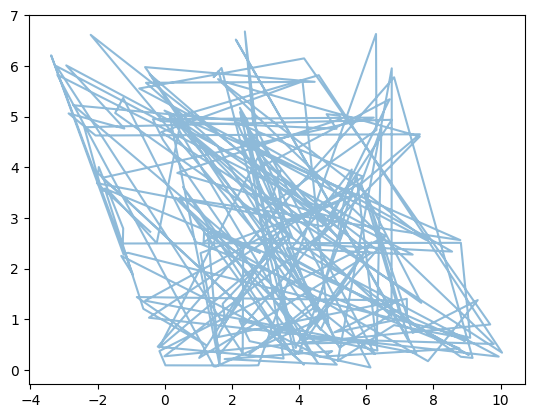

In [90]:
plt.plot(np.array(proton_coord)[:,0], np.array(proton_coord)[:,1],alpha=0.5)

In [80]:
b = xdatcar_proton(md, sample_ase, i)
proton_index = [b[0][np.argmin(b[1])]]
pc = b[2].get_positions()[proton_index]

[[ 3.71558204  6.54368775 11.4079668 ]
 [-0.35425643  1.43899235 11.3926912 ]
 [ 4.84694787  4.57604721 11.0463478 ]
 [-2.18649505  3.96926611 11.3536422 ]
 [ 2.34350889  0.10522355 11.231028  ]
 [-0.24370109  5.99655252 11.5566142 ]
 [ 7.76418343  2.42458208 11.0856554 ]
 [ 2.46501176  4.23780701 11.4072614 ]
 [ 4.93947188  1.95271697 11.483217  ]
 [ 2.4325987   2.13125413 11.2518714 ]
 [ 5.36469635  0.26957737 11.307456  ]
 [ 6.4995952   5.80670685 11.4852404 ]
 [ 0.08442092  3.92965286 11.3213142 ]]


array([[ 5.36469635,  0.26957737, 11.307456  ]])

In [67]:
b[2].get_positions()

array([[ 3.12245546,  1.51421351,  9.516394  ],
       [ 1.90885307,  2.33930547,  9.1071506 ],
       [ 1.85835414,  3.83968969,  9.4825336 ],
       [ 0.59698715,  4.51120439,  8.9801654 ],
       [ 0.56148357,  6.11067645,  9.4969746 ],
       [ 3.22785191,  0.06855268,  9.1018536 ],
       [ 5.84660893,  1.48580983,  9.6413706 ],
       [ 4.4411937 ,  2.19770473,  9.0704342 ],
       [ 4.41631886,  3.67426722,  9.4858098 ],
       [ 3.16136881,  4.49235627,  8.9193928 ],
       [ 3.15476438,  5.94448846,  9.5848956 ],
       [ 5.74052667,  0.03456041,  9.1152662 ],
       [ 8.29678094,  1.55146922,  9.5006482 ],
       [ 7.05216235,  2.27417318,  9.1301618 ],
       [ 7.05822202,  3.7608457 ,  9.511642  ],
       [ 5.64459862,  4.38694873,  9.0091226 ],
       [ 5.6960429 ,  5.98119254,  9.571053  ],
       [ 4.4260655 ,  6.75781576,  9.1050344 ],
       [ 0.60363301,  1.55964351,  9.7252682 ],
       [-0.64257164,  2.23702729,  9.0221884 ],
       [-0.55230186,  3.69531338,  9.467

## Testing on water

In [226]:
CDP_i = deepcdp(None)
CDP_i.create_box(sample_cubeFile='data/water5/h2o-ELECTRON_DENSITY-1_2000.cube', gamma=90)

In [227]:
model.eval()
# Testing 0 Cu structure
test_cube_path = f'data/water5/h2o-ELECTRON_DENSITY-1_2000.cube'
test_cube = read_cube(open(test_cube_path))
ase_atoms_test = test_cube['atoms']
ase_atoms_test.set_pbc((True, True, True))
pos_atoms_test = ase_atoms_test.get_positions()
rho_test = test_cube['data']
rho_test = rho_test.ravel().reshape(-1,1)

start = time.time()
soap_test = soap_W.create(ase_atoms_test, positions=CDP_i.box)
rho_pred = model(torch.tensor(soap_test, dtype=torch.float32).to(device)).cpu().detach().numpy()

end = time.time()
print("Prediction time: ", (end - start), " seconds.")
print(f'R2 value: {skmetrics.r2_score(rho_test,rho_pred):1.2f}')
print(f'MSE value: {skmetrics.mean_squared_error(rho_test,rho_pred):1.5f}')


Prediction time:  3.2978997230529785  seconds.
R2 value: 0.99
MSE value: 0.00005


In [228]:
out_path='example/predictions/water5/pred-GOH_2000.cube'
out=open(out_path,'w+')
rho_test_resp = rho_pred.reshape(*CDP_i.bounds)
write_cube(out,ase_atoms_test,rho_test_resp,origin=CDP_i.box[0])

In [ ]:
cube_predict=open(out_path).read()
cube_dft=open(test_cube_path).read()
struct_path = 'example/structures/water5/water-2000.xyz'
CDP.cube2xyz(test_cube_path,struct_path)
isoval=0.08
xyz=open(struct_path).read()
xyzview = py3Dmol.view(width=400,height=400)
xyzview.addVolumetricData(cube_predict,'cube',{'isoval': isoval,"color":'red','opacity':1,'wireframe':True})
xyzview.addVolumetricData(cube_dft,'cube',{'isoval': isoval,"color":'grey','opacity':1,'wireframe':True})
xyzview.addModel(xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

In [230]:
rho_test_resp.shape
rho_test = test_cube['data']
error = np.abs(rho_test - rho_test_resp)
out=open('example/predictions/water5/pred-2000-error.cube','w+')
write_cube(out,ase_atoms_test,error,origin=CDP_i.box[0])

In [235]:
cube_predict=open(out_path).read()
cube_dft=open(test_cube_path).read()
struct_path = 'example/structures/water5/water-2000.xyz'
CDP.cube2xyz(test_cube_path,struct_path)
isoval=0.08
xyz=open(struct_path).read()
xyzview = py3Dmol.view(width=400,height=400)
# xyzview.addVolumetricData(cube_predict,'cube',{'isoval': isoval,"color":'red','opacity':1,'wireframe':True})
xyzview.addVolumetricData(cube_dft,'cube',{'isoval': isoval,"color":'grey','opacity':1,'wireframe':True})
xyzview.addModel(xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

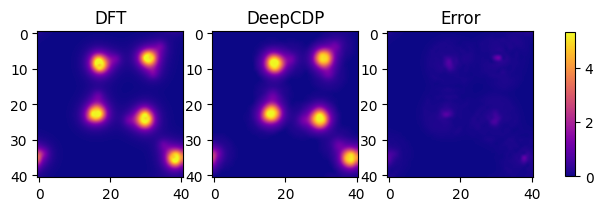

In [237]:
vmin = 0
vmax = 5.3
plt.subplot(131)
plt.imshow(np.trapz(rho_test, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DFT')
plt.subplot(132)
plt.imshow(np.trapz(rho_test_resp, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('DeepCDP')
plt.subplot(133)
plt.imshow(np.trapz(error, axis=2 ), cmap='plasma',
           interpolation ='spline36', vmin=vmin, vmax=vmax)
plt.title('Error')
plt.subplots_adjust(bottom=0.0, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.3, 0.015, 0.3])
plt.colorbar(cax=cax)
plt.savefig('Images/water5-example-2000-c24C.png',dpi=600,bbox_inches="tight",)

In [236]:
error_predict=open('example/predictions/water5/pred-2000-error.cube').read()
xyzview = py3Dmol.view(width=400,height=400)
xyzview.addVolumetricData(error_predict,'cube',{'isoval': 0.08,"color":'blue','opacity':1,'wireframe':True})
# xyzview.addModel(water_xyz,'xyz')
xyzview.setStyle({'stick':{}})
xyzview.zoomTo()
xyzview.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [197]:
def calc_total_elec(rho,spacing_matrix):
    x_cell=spacing_matrix[:,0]
    y_cell=spacing_matrix[:,1]
    z_cell=spacing_matrix[:,2]
    diffV=np.dot(x_cell,np.cross(y_cell,z_cell))
    return np.sum(rho)*diffV

In [208]:
eDFT=calc_total_elec(rho_test, CDP_i.cell_spacing)
eCDP=calc_total_elec(rho_test_resp, CDP_i.cell_spacing)

In [209]:
eDFT, eCDP

(40.51977739526295, 40.87064683284415)

In [210]:
# defining a function that computes and 
# compares the total number of electrons 
#in the system using the model and with DFT

def predict_elect(dft_cube, gamma,model):
    CDP_i = deepcdp(None)
    CDP_i.create_box(sample_cubeFile=dft_cube, gamma=gamma)
    model.eval()
    test_cube = read_cube(open(dft_cube))
    ase_atoms_test = test_cube['atoms']
    ase_atoms_test.set_pbc((True, True, True))
    pos_atoms_test = ase_atoms_test.get_positions()
    rho_test = test_cube['data']
    rho_test = rho_test.ravel().reshape(-1,1)
    soap_test = soap_W.create(ase_atoms_test, positions=CDP_i.box)
    rho_pred = model(torch.tensor(soap_test, dtype=torch.float32).to(device)).cpu().detach().numpy()
    R2_val = skmetrics.r2_score(rho_test,rho_pred)
    MSE_val = skmetrics.mean_squared_error(rho_test,rho_pred)
    rho_pred_resp = rho_pred.reshape(*CDP_i.bounds)
    eDFT=calc_total_elec(rho_test, CDP_i.cell_spacing)
    eCDP=calc_total_elec(rho_pred_resp, CDP_i.cell_spacing)
    return eDFT, eCDP, R2_val, MSE_val
    

In [215]:
data = []
for f in os.listdir('data/water5/'):
    path='data/water5/'+f
    data += [predict_elect(path, 90, model)]
# predict_elect('data/water5/h2o-ELECTRON_DENSITY-1_2000.cube',90, model)

Text(0, 0.5, 'Total valence electrons')

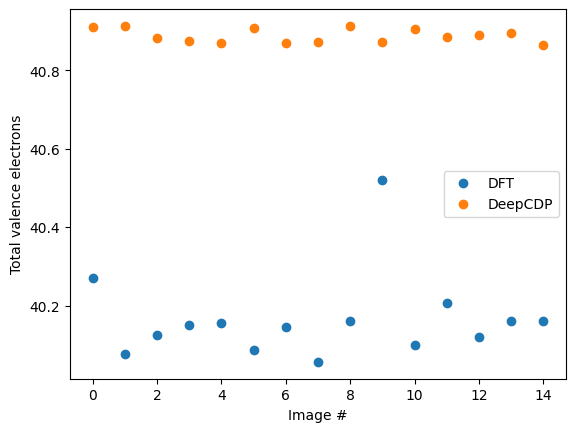

In [225]:
plt.plot(np.array(data)[:,:2],'o')
plt.legend(['DFT','DeepCDP'], frameon=True)
plt.xlabel('Image #')
plt.ylabel('Total valence electrons')

In [ ]:
###### data = np.array(data)
np.mean(data[:,0]) - np.mean(data[:,1])
np.mean(data[:,1]-data[:,0]), np.mean(data[:,0]), np.mean(data[:,1])